<a href="https://colab.research.google.com/github/yassine-cherni/Self-Driving-Car-Focus-/blob/main/YOLOV8-miaw.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 779.6/779.6 kB 4.0 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-m

In [2]:
# Import Essential Libraries
import os
import random
import pandas as pd
from PIL import Image
import cv2
from ultralytics import YOLO
from IPython.display import Video
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='darkgrid')
import pathlib
import glob
from tqdm.notebook import trange, tqdm
import warnings
warnings.filterwarnings('ignore')

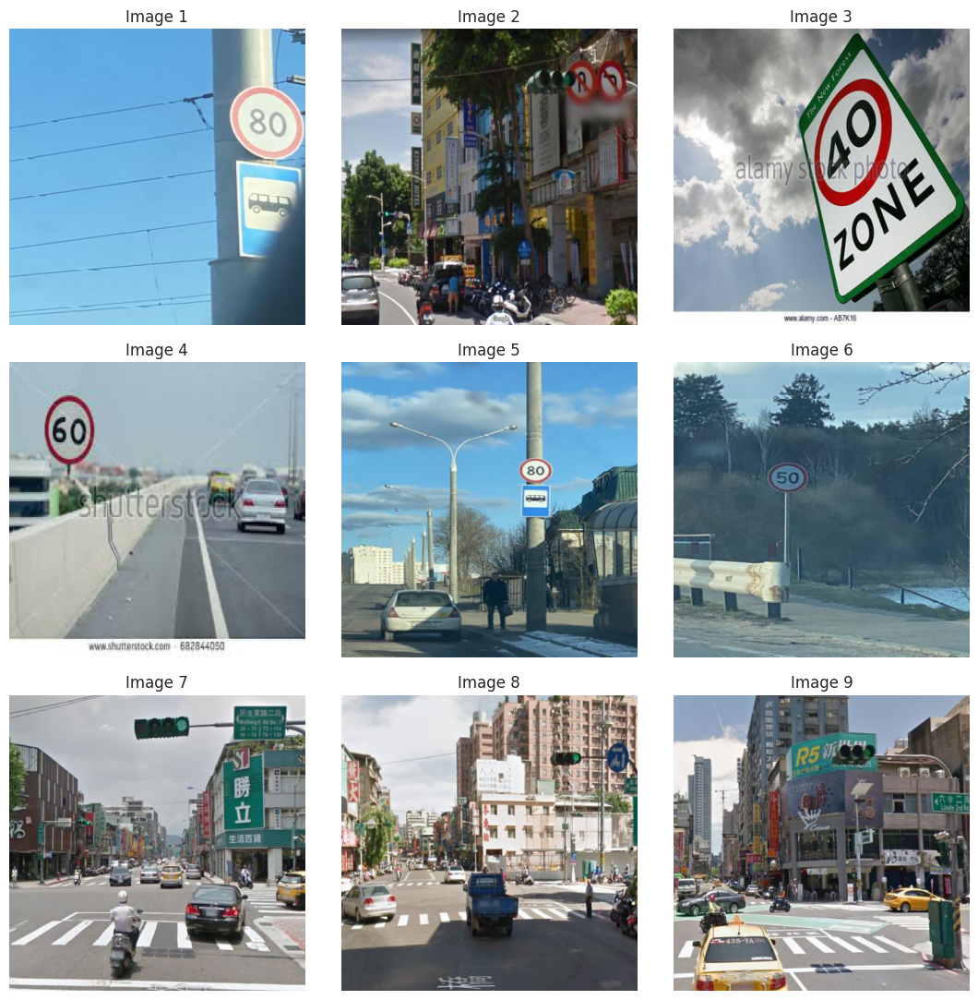

In [3]:
Image_dir = '/content/drive/MyDrive/Traffic/train/images'

num_samples = 9
image_files = os.listdir(Image_dir)

# Randomly select num_samples images
rand_images = random.sample(image_files, num_samples)

fig, axes = plt.subplots(3, 3, figsize=(11, 11))

for i in range(num_samples):
    image = rand_images[i]
    ax = axes[i // 3, i % 3]
    ax.imshow(plt.imread(os.path.join(Image_dir, image)))
    ax.set_title(f'Image {i+1}')
    ax.axis('off')

plt.tight_layout()
plt.show()

In [4]:
# Get the size of the image
image = cv2.imread("/content/drive/MyDrive/Traffic/train/images/00000_00000_00012_png.rf.23f94508dba03ef2f8bd187da2ec9c26.jpg")
h, w, c = image.shape
print(f"The image has dimensions {w}x{h} and {c} channels.")

The image has dimensions 416x416 and 3 channels.


100%|██████████| 6.23M/6.23M [00:00<00:00, 74.2MB/s]



image 1/1 /content/drive/MyDrive/pente-Bizerte.jpg: 320x416 1 traffic light, 1 stop sign, 269.1ms
Speed: 17.3ms preprocess, 269.1ms inference, 1668.7ms postprocess per image at shape (1, 3, 320, 416)


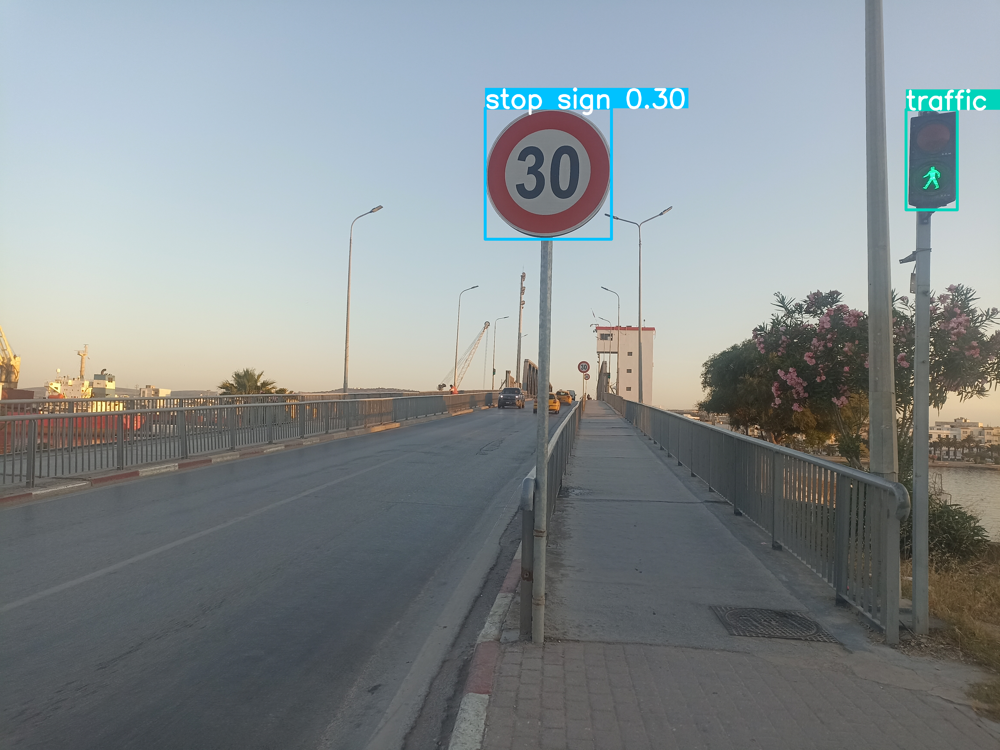

In [5]:
# Use a pretrained YOLOv8n model
model = YOLO("yolov8n.pt")

# Use the model to detect object
image = "/content/drive/MyDrive/pente-Bizerte.jpg"
result_predict = model.predict(source = image, imgsz=(416))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [ ]:
# Build from YAML and transfer weights
Final_model = YOLO('yolov8n.yaml').load('yolov8n.pt')
print(Final_model.info())

# Training The Final Model
Result_Final_model = Final_model.train(
    data="/content/drive/MyDrive/Traffic/data.yaml",
    epochs=100,
    imgsz = 416,
    batch = 64 ,
    lr0=0.0001,
    dropout= 0.15,
    device = "0")

Transferred 355/355 items from pretrained weights
YOLOv8n summary: 225 layers, 3157200 parameters, 3157184 gradients, 8.9 GFLOPs
(225, 3157200, 3157184, 8.8575488)
Ultralytics YOLOv8.2.27 🚀 Python-3.10.12 torch-2.3.0+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/content/drive/MyDrive/Traffic/data.yaml, epochs=100, time=None, patience=100, batch=64, imgsz=416, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.15, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic

100%|██████████| 755k/755k [00:00<00:00, 15.3MB/s]


Overriding model.yaml nc=80 with nc=15

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

train: Scanning /content/drive/MyDrive/Traffic/train/labels.cache... 3530 images, 13 backgrounds, 0 corrupt: 100%|██████████| 3540/3540 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/Traffic/valid/labels.cache... 801 images, 0 backgrounds, 0 corrupt: 100%|██████████| 801/801 [00:00<?, ?it/s]

Plotting labels to runs/detect/train/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000526, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 416 train, 416 val
Using 0 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G     0.8324      3.479      1.087         41        416: 100%|██████████| 56/56 [28:58<00:00, 31.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [06:08<00:00, 52.66s/it]

                   all        801        944     0.0615      0.772       0.15      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G     0.7261       2.34       1.02         52        416: 100%|██████████| 56/56 [26:01<00:00, 27.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [02:16<00:00, 19.45s/it]

                   all        801        944      0.335      0.417      0.268      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G     0.7297      1.992      1.007         43        416: 100%|██████████| 56/56 [25:31<00:00, 27.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [02:16<00:00, 19.52s/it]

                   all        801        944       0.31      0.464      0.343      0.272



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G     0.7129      1.785      1.004        128        416:  68%|██████▊   | 38/56 [18:08<08:38, 28.81s/it]

In [ ]:
metrics = ["P_curve.png", "R_curve.png", "confusion_matrix.png"]
for metric in metrics:
    img = cv2.imread(f'/content/runs/detect/train/{metric}')
    plt.figure(figsize=(12, 8))  # Adjust figure size as needed
    plt.imshow(img)
    plt.axis("off")  # Remove axis labels
    plt.title(metric.replace("_", " ").replace(".png", "").title())
    plt.show()

In [ ]:
Result_Final_model = pd.read_csv('/content/runs/detect/train/results.csv')
Result_Final_model.columns = Result_Final_model.columns.str.strip()

plt.figure(figsize=(16, 6))

In [ ]:
# Plot training and validation loss
plt.plot(Result_Final_model['epoch'], Result_Final_model['train/box_loss'], label='Training Box Loss')
plt.plot(Result_Final_model['epoch'], Result_Final_model['val/box_loss'], label='Validation Box Loss')

# Plot training and validation accuracy (assuming 'metrics/mAP50(B)' is your accuracy metric)
plt.plot(Result_Final_model['epoch'], Result_Final_model['metrics/mAP50(B)'], label='Training mAP@0.5')
plt.plot(Result_Final_model['epoch'], Result_Final_model['metrics/mAP50-95(B)'], label='Validation mAP@0.5:0.95')

plt.xlabel('Epoch')
plt.ylabel('Loss / mAP')
plt.title('YOLOv8 Training: Loss and mAP')
plt.legend()
plt.grid(True)
plt.show()

# [Figure 2.V: YOLOv8 Training: Loss and mAP.
# This figure presents the training and validation curves
# for both box loss and mean Average Precision (mAP).
# Analyze the trends in the curves and discuss any observations,
# such as overfitting or the rate of model convergence.]

# Cell 9: Plot Other Training Metrics
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(15, 10))

sns.lineplot(x='epoch', y='metrics/precision(B)', data=Result_Final_model, ax=axs[0, 0])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=Result_Final_model, ax=axs[0, 1])
sns.lineplot(x='epoch', y='train/cls_loss', data=Result_Final_model, ax=axs[1, 0])
sns.lineplot(x='epoch', y='val/cls_loss', data=Result_Final_model, ax=axs[1, 1])

axs[0, 0].set(title='Precision (B)')
axs[0, 1].set(title='Recall (B)')
axs[1, 0].set(title='Train Classification Loss')
axs[1, 1].set(title='Validation Classification Loss')

plt.suptitle('Additional Training Metrics', fontsize=20)
plt.tight_layout()
plt.show()

# [Figure 2.U: Additional Training Metrics.
# This figure visualizes the trends of precision, recall,
# and classification loss during the YOLOv8 training process.]

# --- 4. Model Evaluation on Test Set ---

# Cell 10: Load Best Model and Evaluate
Valid_model = YOLO('/content/runs/detect/train/weights/best.pt')
metrics = Valid_model.val(split='test')

# Print final evaluation results
print("Precision (B): ", metrics.results_dict["metrics/precision(B)"])
print("Recall (B): ", metrics.results_dict["metrics/recall(B)"])
print("mAP@0.5 (B): ", metrics.results_dict["metrics/mAP50(B)"])
print("mAP@0.5:0.95 (B): ", metrics.results_dict["metrics/mAP50-95(B)"])

# --- 5. Inference on Test Images ---

# Cell 11: Perform Detection on Test Images and Visualize Results
image_dir = '/content/drive/MyDrive/Traffic/test/images'
image_files = [os.path.join(image_dir, file) for file in os.listdir(image_dir) if file.endswith('.jpg')]
random_images = random.sample(image_files, k=10)

for image_path in random_images:
    image = cv2.imread(image_path)
    results = Final_model.predict([image], save=True, imgsz=416, conf=0.5, iou=0.7)

# View results (adjust range if you saved more images)
for i in range(2, 12):
    plt.imshow(plt.imread(f'/content/runs/detect/train{i}/image0.jpg'))
    plt.axis("off")  # Optional: Remove axis labels for cleaner visualization
    plt.show()

# [Figure 2.T: Detection Results on Test Images.
# This figure showcases the performance of the fine-tuned YOLOv8
# model on a set of test images, highlighting its ability to accurately
# detect and classify traffic signs in unseen data.]

# --- 6. Model Export ---

# Cell 12: Export the Model to ONNX Format
video_model = model
video_model.export(format='onnx')